In [8]:
#import required functions
import warnings
warnings.filterwarnings("ignore")
import math
import os
import pandas as pd
from pandas import ExcelWriter
from pandas import ExcelFile
import pylab as plt
import numpy as np
from IPython.display import Image
import matplotlib as matplotlib
import datetime
from pandas import DataFrame
from openpyxl import load_workbook
from openpyxl.drawing.image import Image
from statsmodels.tsa.statespace.sarimax import SARIMAX
import statsmodels.api as sm
import matplotlib.pyplot as plt; plt.rcdefaults()
import matplotlib.pyplot as plt
plt.style.use('fivethirtyeight')
import itertools
from fbprophet import Prophet
from scipy.interpolate import interp1d
from sklearn.preprocessing import StandardScaler
from boto.mws.connection import MWSConnection

In [9]:
import boto
from time import sleep
import subprocess
import json
import time
from boto.s3.connection import S3Connection
import boto3

In [10]:
%store -r

In [4]:
forecast = boto3.client(service_name='forecast') 
forecastquery = boto3.client(service_name='forecastquery')

INFO:botocore.credentials:Found credentials in shared credentials file: ~/.aws/credentials


In [11]:
print(project)
predictorName= project+'_arima3'

forecast_arima_proj2


In [12]:
forecastHorizon = 24

algorithmArn = 'arn:aws:forecast:::algorithm/ARIMA'

In [14]:
create_predictor_response=forecast.create_predictor(PredictorName=predictorName, 
                                                  AlgorithmArn=algorithmArn,
                                                  ForecastHorizon=forecastHorizon,
                                                  PerformAutoML= False,
                                                  PerformHPO=False,
                                                  EvaluationParameters= {"NumberOfBacktestWindows": 1, 
                                                                         "BackTestWindowOffset": 24}, 
                                                  InputDataConfig= {"DatasetGroupArn": datasetGroupArn},
                                                  FeaturizationConfig= {"ForecastFrequency": "W", 
                                                                        "Featurizations": 
                                                                        [
                                                                          {"AttributeName": "demand", 
                                                                           "FeaturizationPipeline": 
                                                                            [
                                                                              {"FeaturizationMethodName": "filling", 
                                                                               "FeaturizationMethodParameters": 
                                                                                {"frontfill": "none", 
                                                                                 "aggregation": "avg", 
                                                                                 "backfill": "nan"}
                                                                              }
                                                                            ]
                                                                          }
                                                                        ]
                                                                       })

In [15]:
predictor_arn=create_predictor_response['PredictorArn']

In [16]:
while True:
    predictorStatus = forecast.describe_predictor(PredictorArn=predictor_arn)['Status']
    print(predictorStatus)
    if predictorStatus != 'ACTIVE' and predictorStatus != 'CREATE_FAILED':
        sleep(30)
    else:
        break

CREATE_PENDING
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
ACTIVE


In [17]:
forecast.get_accuracy_metrics(PredictorArn=predictor_arn)

{'PredictorEvaluationResults': [{'AlgorithmArn': 'arn:aws:forecast:::algorithm/ARIMA',
   'TestWindows': [{'EvaluationType': 'SUMMARY',
     'Metrics': {'RMSE': 1.295436326736468,
      'WeightedQuantileLosses': [{'Quantile': 0.9,
        'LossValue': 0.4741177540972706},
       {'Quantile': 0.5, 'LossValue': 0.6616312066207959},
       {'Quantile': 0.1, 'LossValue': 0.36545278836113476}]}},
    {'TestWindowStart': datetime.datetime(2019, 4, 13, 17, 0, tzinfo=tzlocal()),
     'TestWindowEnd': datetime.datetime(2019, 9, 28, 17, 0, tzinfo=tzlocal()),
     'ItemCount': 180,
     'EvaluationType': 'COMPUTED',
     'Metrics': {'RMSE': 1.295436326736468,
      'WeightedQuantileLosses': [{'Quantile': 0.9,
        'LossValue': 0.4741177540972706},
       {'Quantile': 0.5, 'LossValue': 0.6616312066207959},
       {'Quantile': 0.1, 'LossValue': 0.36545278836113476}]}}]}],
 'ResponseMetadata': {'RequestId': '4b8b372e-2fb3-44ed-8923-86b4fc368513',
  'HTTPStatusCode': 200,
  'HTTPHeaders': {'conten

In [18]:
forecastName= project+'_arima_forecast'

In [19]:
create_forecast_response=forecast.create_forecast(ForecastName=forecastName,
                                                  PredictorArn=predictor_arn)
forecast_arn = create_forecast_response['ForecastArn']

In [20]:
while True:
    forecastStatus = forecast.describe_forecast(ForecastArn=forecast_arn)['Status']
    print(forecastStatus)
    if forecastStatus != 'ACTIVE' and forecastStatus != 'CREATE_FAILED':
        sleep(30)
    else:
        break

CREATE_PENDING
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
CREATE_IN_PROGRESS
ACTIVE


In [80]:
print(forecast_arn)
print()
forecastResponse = forecastquery.query_forecast(
    ForecastArn=forecast_arn,
    Filters={"item_id":"PGF1108-NAT-XX"})
print(forecastResponse)


arn:aws:forecast:us-west-2:664621939161:forecast/forecast_arima_proj2_arima_forecast

{'Forecast': {'Predictions': {'p10': [{'Timestamp': '2019-09-23T00:00:00', 'Value': 5.2884745597839355}, {'Timestamp': '2019-09-30T00:00:00', 'Value': 4.427005290985107}, {'Timestamp': '2019-10-07T00:00:00', 'Value': 3.8304266929626465}, {'Timestamp': '2019-10-14T00:00:00', 'Value': 3.3812146186828613}, {'Timestamp': '2019-10-21T00:00:00', 'Value': 3.0295774936676025}, {'Timestamp': '2019-10-28T00:00:00', 'Value': 2.747953414916992}, {'Timestamp': '2019-11-04T00:00:00', 'Value': 2.518913984298706}, {'Timestamp': '2019-11-11T00:00:00', 'Value': 2.330538034439087}, {'Timestamp': '2019-11-18T00:00:00', 'Value': 2.1742477416992188}, {'Timestamp': '2019-11-25T00:00:00', 'Value': 2.0436525344848633}, {'Timestamp': '2019-12-02T00:00:00', 'Value': 1.933870792388916}, {'Timestamp': '2019-12-09T00:00:00', 'Value': 1.8411040306091309}, {'Timestamp': '2019-12-16T00:00:00', 'Value': 1.7623533010482788}, {'Timestam

In [81]:
%store forecast_arn
%store predictor_arn

Stored 'forecast_arn' (str)
Stored 'predictor_arn' (str)


In [82]:
def load_exact_sol(fname, item_id, is_schema_perm=False):
    exact = pd.read_csv(fname, header = None)
    exact.columns = ['item_id', 'timestamp', 'target']
    if is_schema_perm:
        exact.columns = ['timestamp', 'target', 'item_id']
    return exact.loc[exact['item_id'] == item_id]

In [83]:
def plot_forecasts(fcsts, exact, freq = '1H', forecastHorizon=24, time_back = 80):
    p10 = pd.DataFrame(fcsts['Forecast']['Predictions']['p10'])
    p50 = pd.DataFrame(fcsts['Forecast']['Predictions']['p50'])
    p90 = pd.DataFrame(fcsts['Forecast']['Predictions']['p90'])
    pred_int = p50['Timestamp'].apply(lambda x: pd.Timestamp(x))
    fcst_start_date = pred_int[0]
    time_int = exact['timestamp'].apply(lambda x: pd.Timestamp(x))
    plt.plot(time_int[-time_back:],exact['target'].values[-time_back:], color = 'r')
    plt.plot(pred_int, p50['Value'].values, color = 'k');
    plt.fill_between(p50['Timestamp'].values, 
                     p10['Value'].values,
                     p90['Value'].values,
                     color='b', alpha=0.3);
    plt.axvline(x=pd.Timestamp(fcst_start_date), linewidth=3, color='g', ls='dashed');
    plt.axvline(x=pd.Timestamp(fcst_start_date, freq)+forecastHorizon-1, linewidth=3, color='g', ls='dashed');
    plt.xticks(rotation=30);
    plt.legend(['Target', 'Forecast'], loc = 'lower left')

In [84]:
import logging
client='petergrimm'

%load_ext autoreload
%autoreload 2
sku='PGF1108-NAT-XX'
import warnings
import boto3
import s3fs
plt.rcParams['figure.figsize'] = (15.0, 5.0)
warnings.filterwarnings('ignore')
exact=load_exact_sol('/Users/JoyThompson/Desktop/'+ client+'/input/input.csv', sku)


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [90]:

#exact=exact.drop(columns=['item_id'], axis=0)
pred=forecastResponse['Forecast']
forecast=pred['Predictions']
forecast=forecast['p10']
forecastpd=pd.DataFrame(forecast)
for ind in forecastpd.index:
    time=forecastpd.iloc[ind, 0]
    time=str(time)[0:10]
    forecastpd.iloc[ind,0]=pd.to_datetime(time)

for ind in exact.index:
    time=exact.loc[ind, 'timestamp']
    time=str(time)[0:10]
    exact.loc[ind,'timestamp']=pd.to_datetime(time)
exact=exact.set_index('timestamp')
forecastpd=forecastpd.set_index('Timestamp')

                timestamp target
6155  2018-02-18 00:00:00    3.0
6156  2018-02-25 00:00:00    3.0
6157  2018-03-11 00:00:00    4.2
6158  2018-03-18 00:00:00    4.2
6159  2018-03-25 00:00:00    4.2
6160  2018-04-01 00:00:00    4.2
6161  2018-04-08 00:00:00    4.2
6162  2018-04-15 00:00:00    4.2
6163  2018-04-22 00:00:00    4.2
6164  2018-04-29 00:00:00    4.2
6165  2018-05-06 00:00:00   9.42
6166  2018-05-13 00:00:00   9.42
6167  2018-05-20 00:00:00   9.42
6168  2018-05-27 00:00:00   9.42
6169  2018-06-03 00:00:00   9.42
6170  2018-06-10 00:00:00   9.42
6171  2018-06-17 00:00:00   9.42
6172  2018-06-24 00:00:00   9.42
6173  2018-07-01 00:00:00  12.19
6174  2018-07-08 00:00:00  12.19
6175  2018-07-15 00:00:00  12.19
6176  2018-07-22 00:00:00  12.19
6177  2018-07-29 00:00:00  12.19
6178  2018-08-05 00:00:00   8.35
6179  2018-08-12 00:00:00   8.35
6180  2018-08-19 00:00:00   8.35
6181  2018-08-26 00:00:00   8.35
6182  2018-09-02 00:00:00   8.35
6183  2018-09-09 00:00:00   8.35
6184  2018

In [93]:
for ind in exact.index:
    val=exact.loc[ind, 'target']
    exact.loc[ind, 'target']=float(val)

           target
timestamp        
2018-02-18    3.0
2018-02-25    3.0
2018-03-11    4.2
2018-03-18    4.2
2018-03-25    4.2
2018-04-01    4.2
2018-04-08    4.2
2018-04-15    4.2
2018-04-22    4.2
2018-04-29    4.2
2018-05-06   9.42
2018-05-13   9.42
2018-05-20   9.42
2018-05-27   9.42
2018-06-03   9.42
2018-06-10   9.42
2018-06-17   9.42
2018-06-24   9.42
2018-07-01  12.19
2018-07-08  12.19
2018-07-15  12.19
2018-07-22  12.19
2018-07-29  12.19
2018-08-05   8.35
2018-08-12   8.35
2018-08-19   8.35
2018-08-26   8.35
2018-09-02   8.35
2018-09-09   8.35
2018-09-16   8.35
...           ...
2019-01-13   1.13
2019-01-20   1.13
2019-01-27   1.13
2019-02-03    6.0
2019-02-10    6.0
2019-02-17    6.0
2019-02-24    6.0
2019-03-03   8.65
2019-03-10   8.65
2019-03-17   8.65
2019-03-24   8.65
2019-03-31   8.65
2019-04-07   8.65
2019-04-14   8.65
2019-04-21   8.65
2019-04-28   8.65
2019-05-05   3.79
2019-05-12   3.79
2019-05-19   3.79
2019-05-26   3.79
2019-07-21    6.0
2019-07-28    6.0
2019-08-04

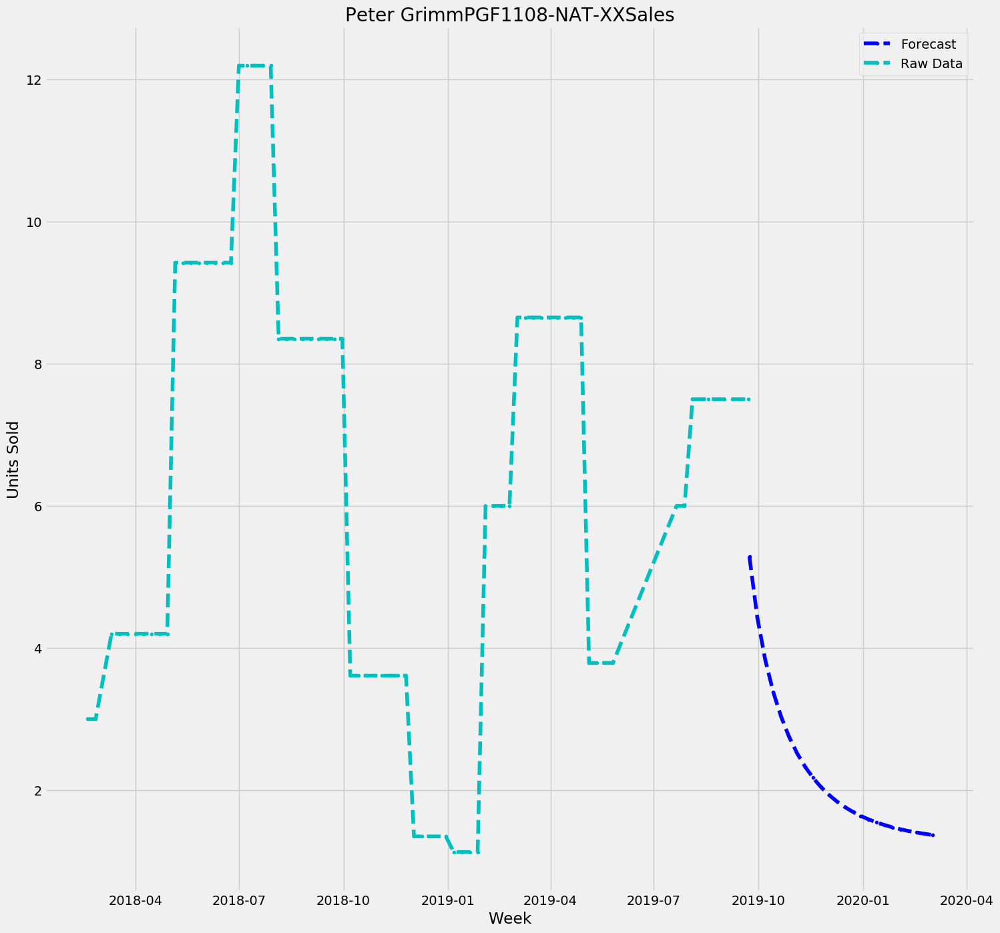

In [94]:
fig, axes = plt.subplots(1,1, figsize=(16,16));
plt.style.use('fivethirtyeight');
axes.plot(forecastpd, '--.b')
axes.plot(exact, '--.c')
axes.set_ylabel('Units Sold');
axes.set_xlabel('Week');
axes.set_title('Peter Grimm'+sku +'Sales');
axes.legend( ('Forecast','Raw Data'))

In [96]:
client='petergrimm'
directory= '/Users/JoyThompson/Desktop/'+ client+'/forecastaws/clientforecastrawdata.xlsx'
forecastskull= pd.read_excel(directory, sheetname='Product Forecast Data')
print(forecastskull)

       Unnamed: 0     Product SKU       Week  Total Week Product Sales  \
0               0   PGA1215-GRY-A 2018-02-11                       NaN   
1               1   PGA1215-GRY-A 2018-02-18                       NaN   
2               2   PGA1215-GRY-A 2018-02-25                       NaN   
3               3   PGA1215-GRY-A 2018-03-04                       NaN   
4               4   PGA1215-GRY-A 2018-03-11                       NaN   
5               5   PGA1215-GRY-A 2018-03-18                       NaN   
6               6   PGA1215-GRY-A 2018-03-25                       NaN   
7               7   PGA1215-GRY-A 2018-04-01                       NaN   
8               8   PGA1215-GRY-A 2018-04-08                       NaN   
9               9   PGA1215-GRY-A 2018-04-15                       NaN   
10             10   PGA1215-GRY-A 2018-04-22                       NaN   
11             11   PGA1215-GRY-A 2018-04-29                       NaN   
12             12   PGA1215-GRY-A 2018

In [98]:
forecastskull=forecastskull.drop(columns=['Unnamed: 0'], axis=0)
skulist=[]
for ind in forecastskull.index:
    sku=forecastskull.loc[ind, 'Product SKU']
    if sku not in skulist:
        skulist.append(sku)

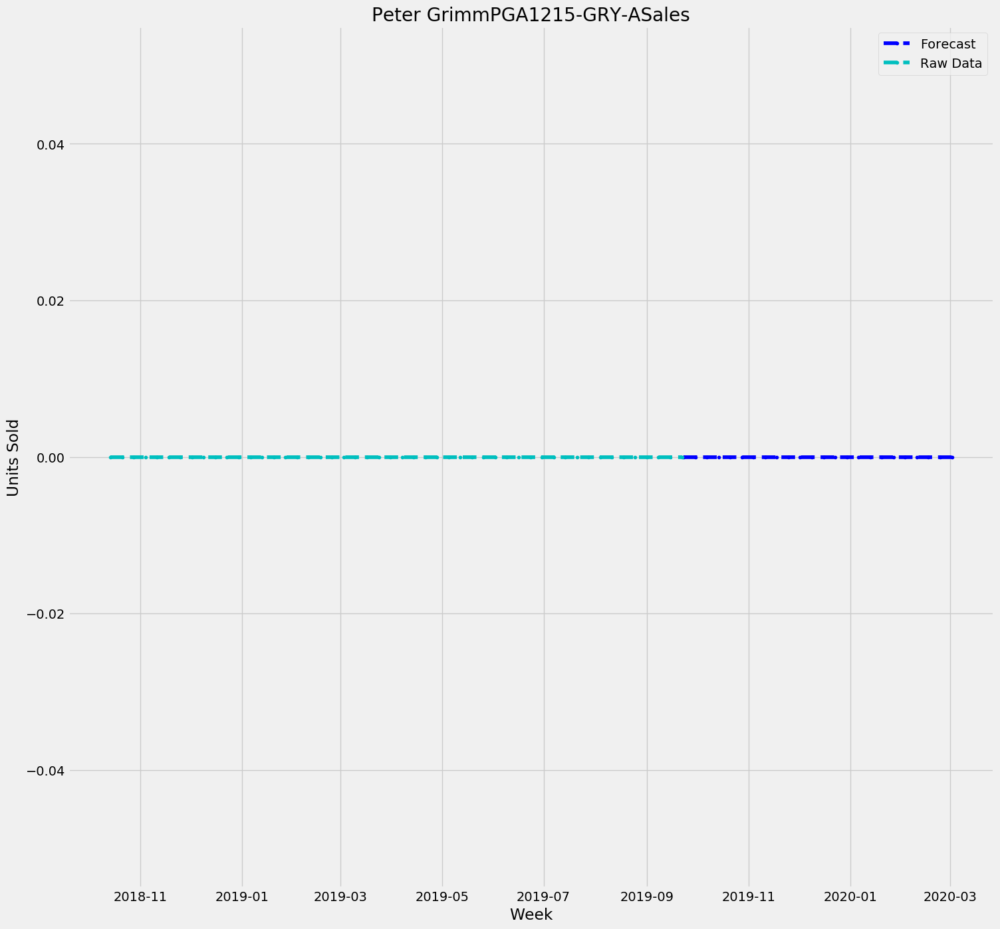

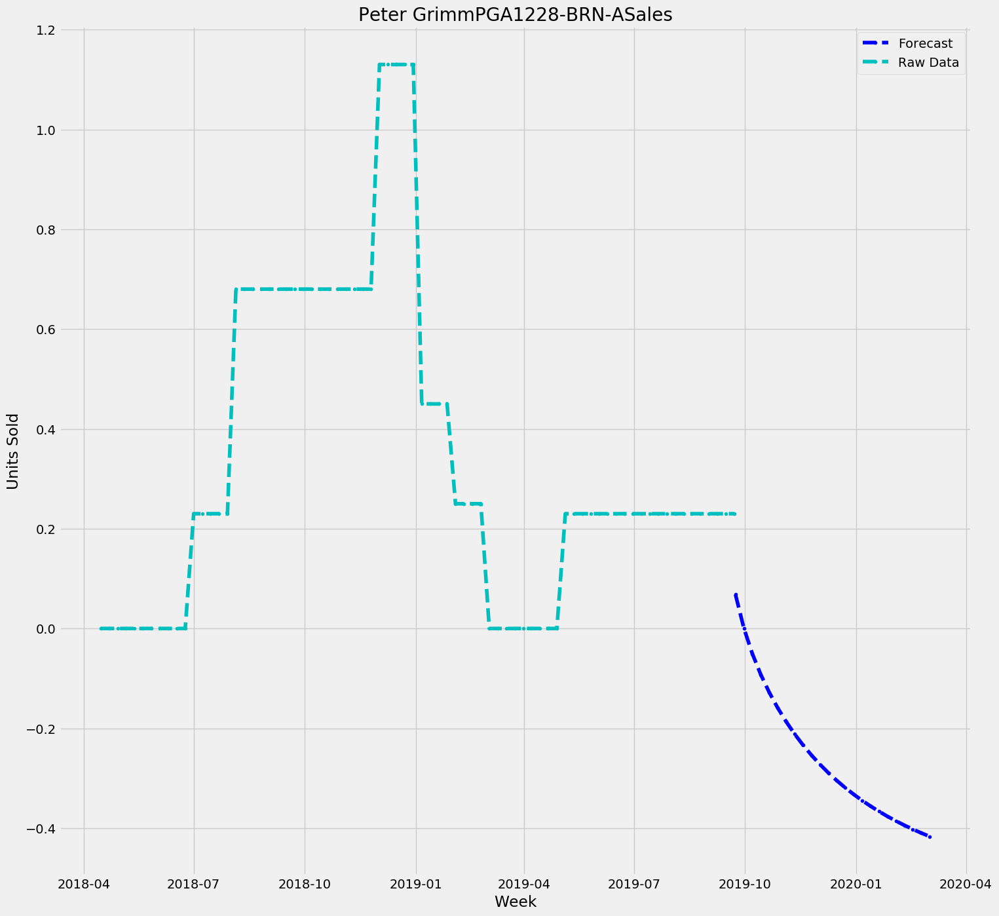

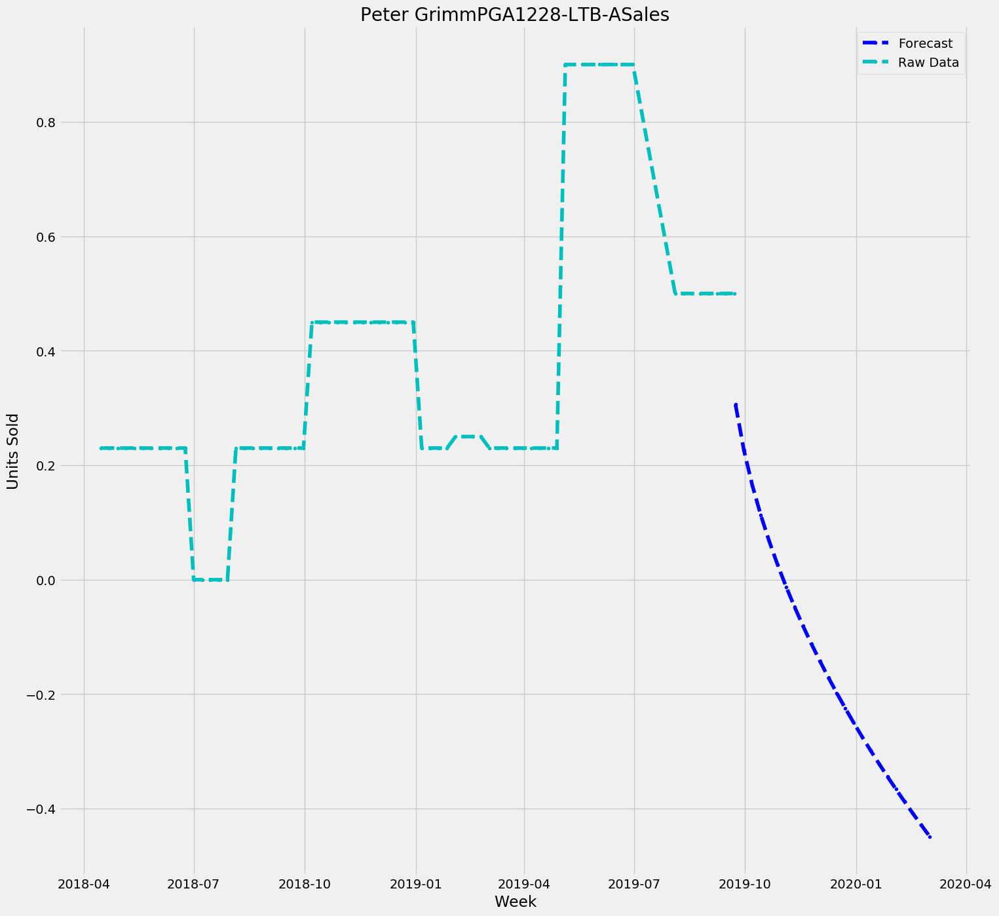

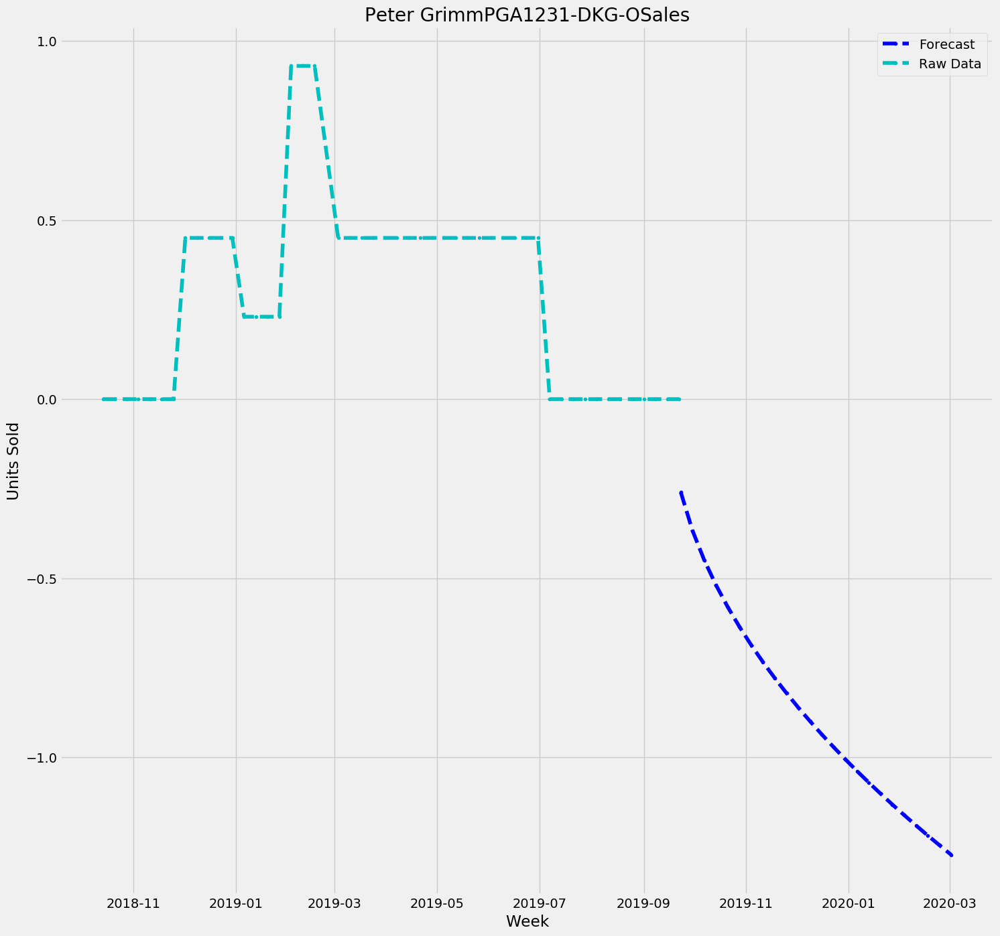

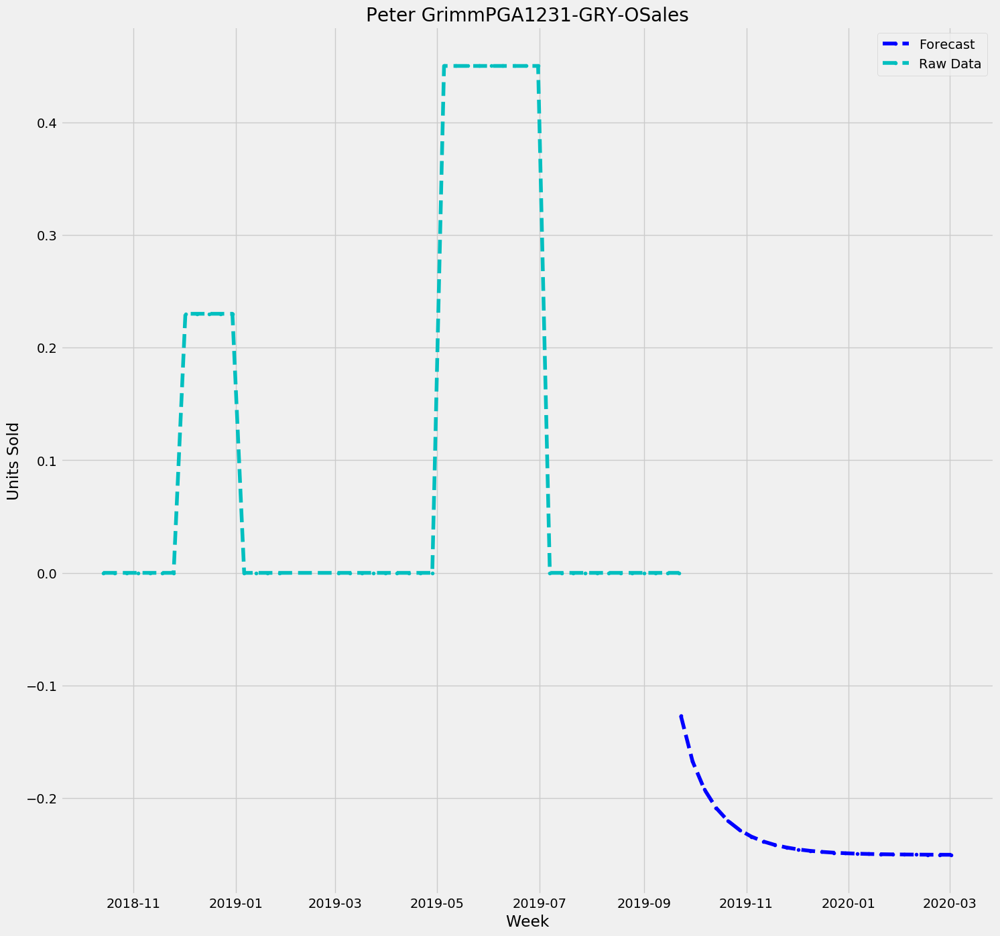

...

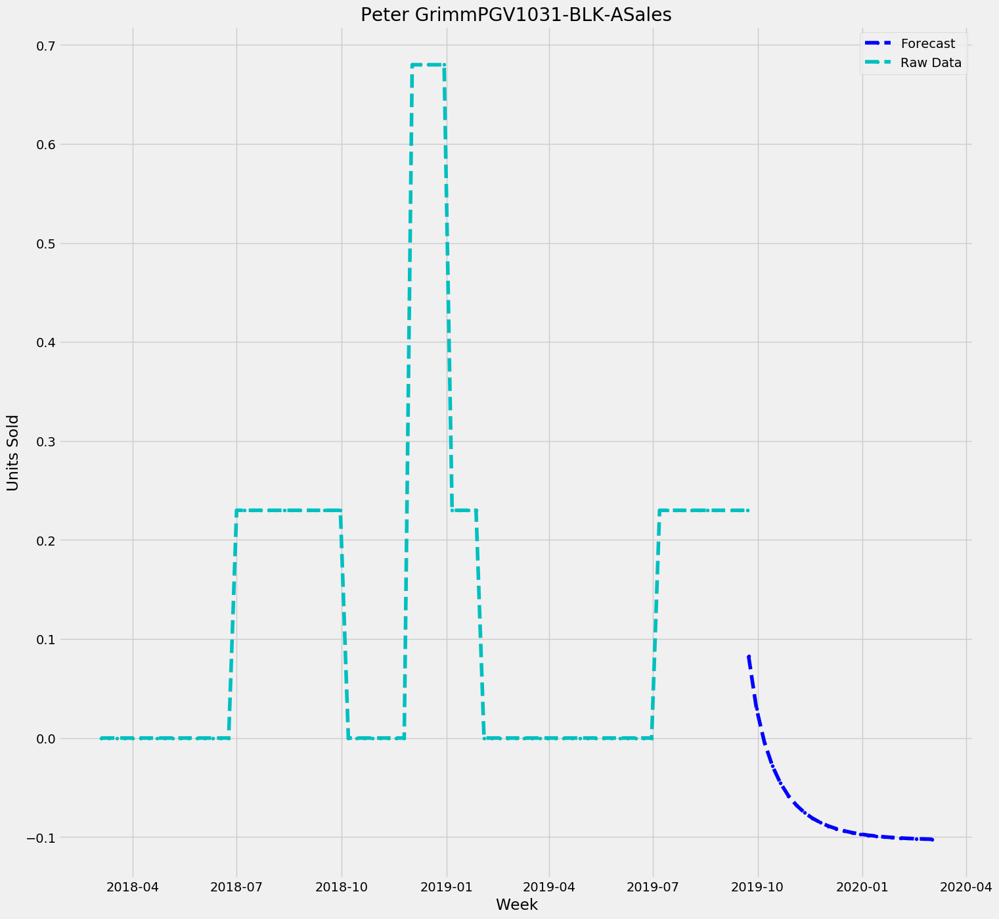

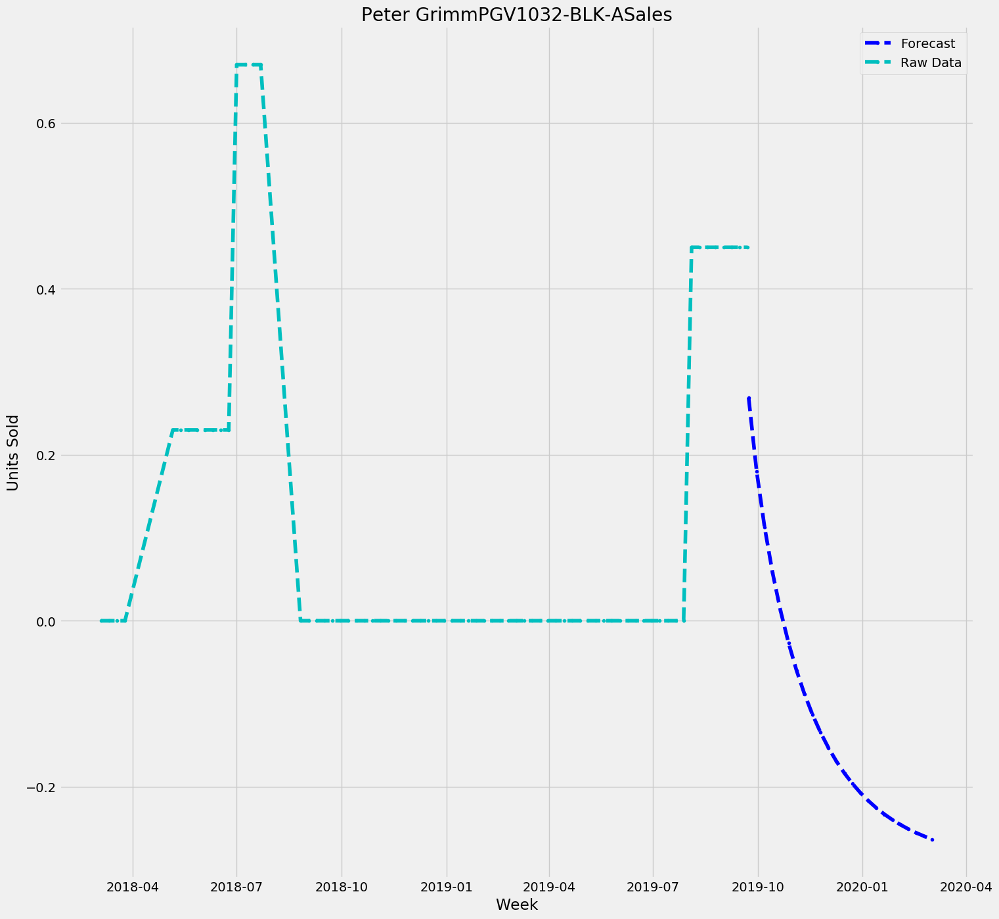

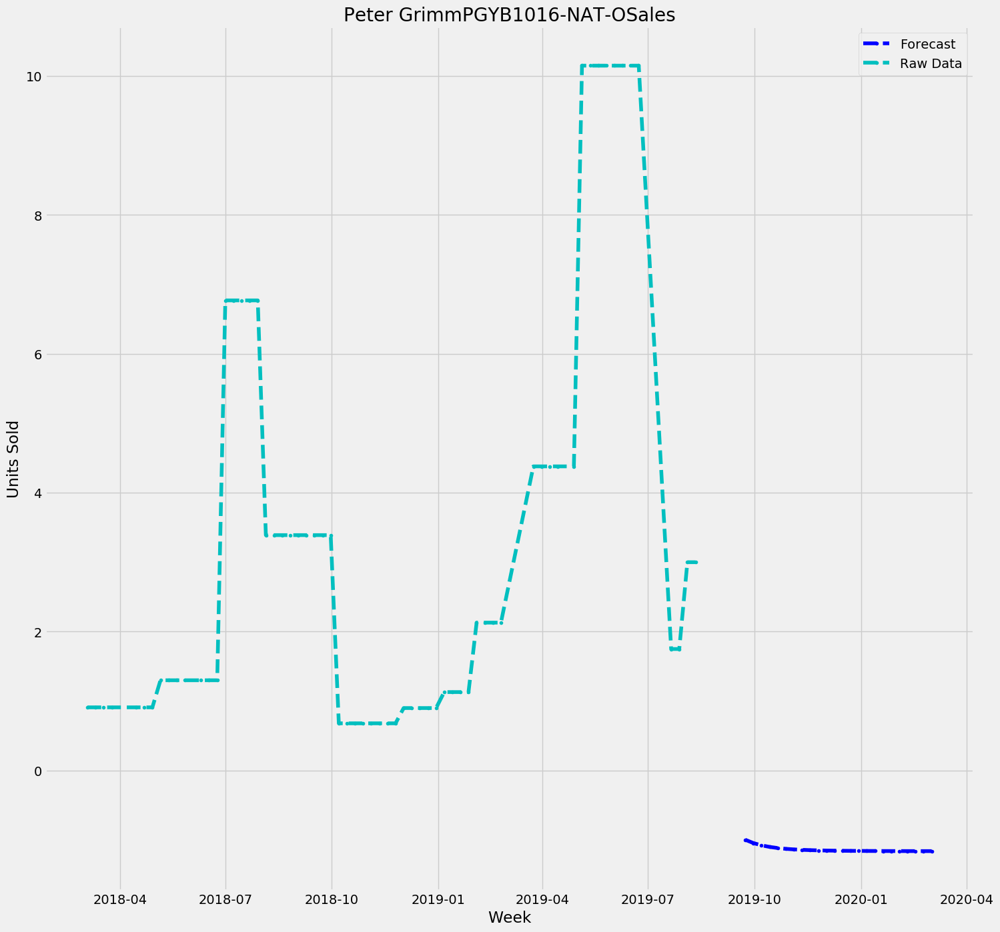

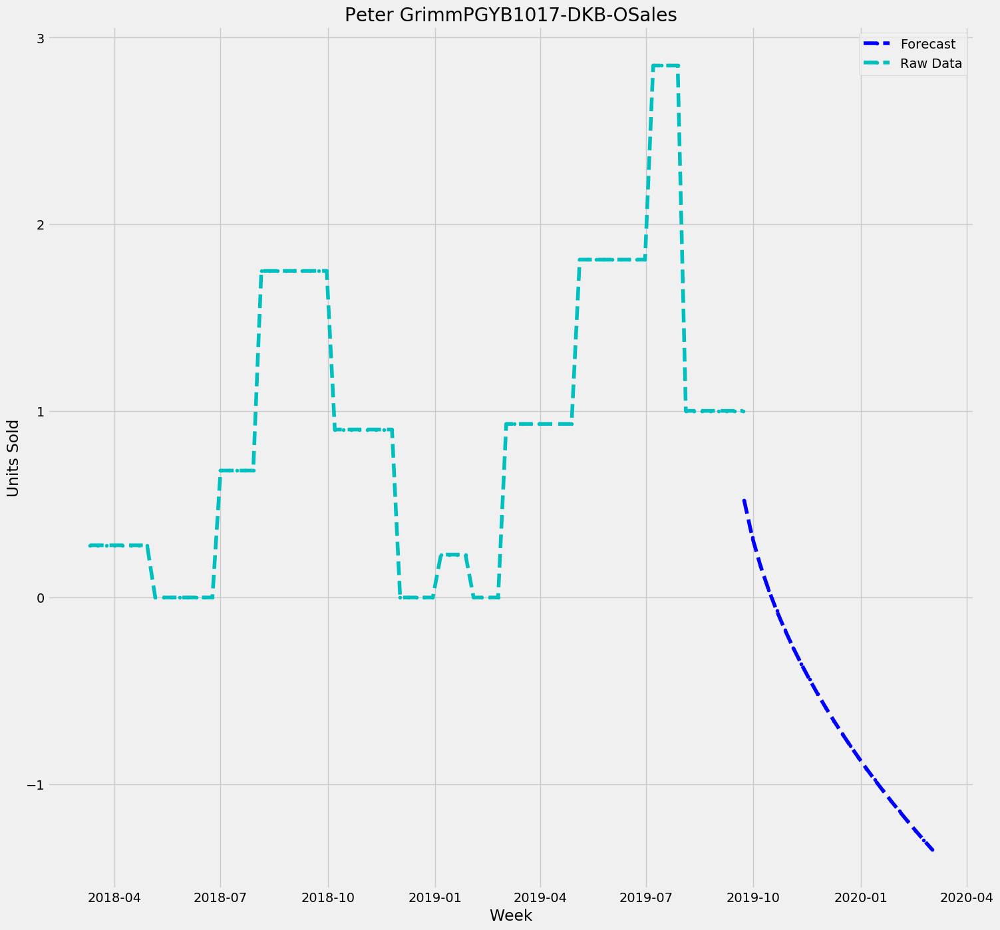

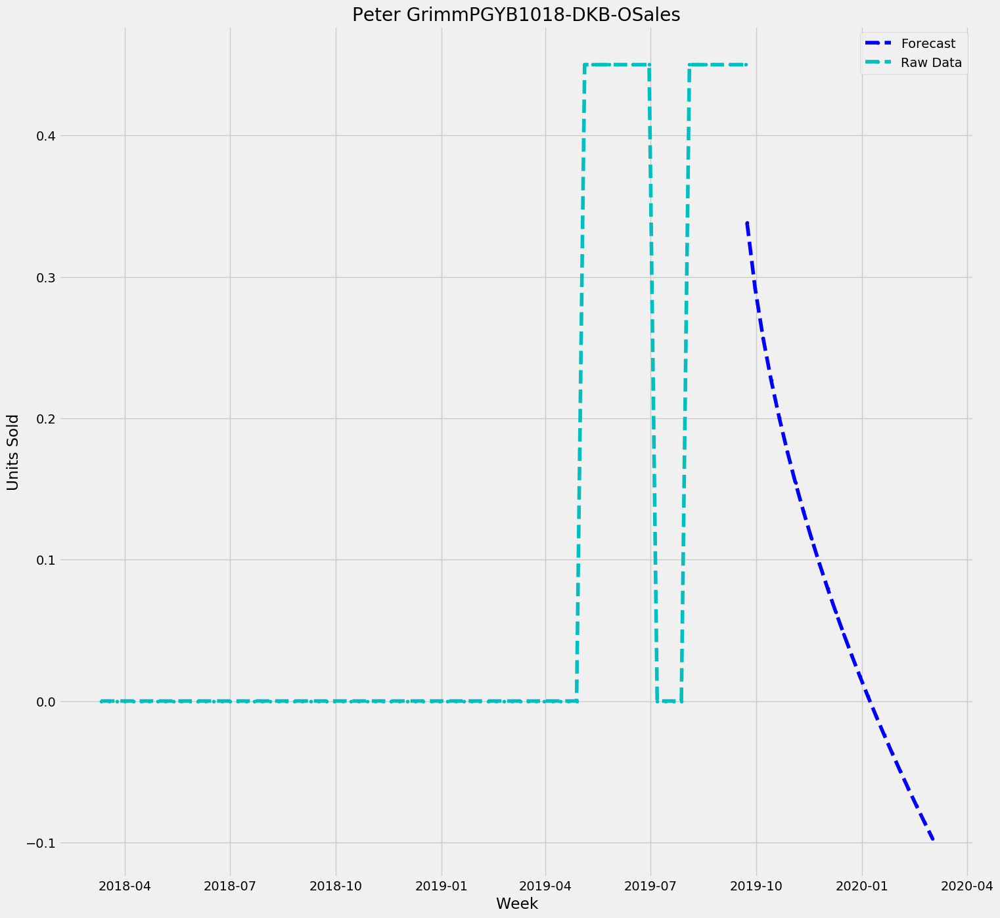

In [113]:
forecastxl=pd.DataFrame(columns=['Product SKU','Week', 'Product Sales', 'Lower Bound Product Sales', 'Upper Bound Product Sales'])
forecastroll=pd.DataFrame(columns=['Product SKU','Quantity to Date', 'Total Rollout Quantity'])
for sku in skulist:
    forecastResponse = forecastquery.query_forecast(
    ForecastArn=forecast_arn,
    Filters={'item_id':sku})
    exact=load_exact_sol('/Users/JoyThompson/Desktop/'+ client+'/input/input.csv', sku)
    pred=forecastResponse['Forecast']
    forecast=pred['Predictions']
    forecast=forecast['p10']
    forecastpd=pd.DataFrame(forecast)
    totalrollout=0
    for ind in forecastpd.index:
        time=forecastpd.iloc[ind, 0]
        quant=forecastpd.iloc[ind, 1]
        time=str(time)[0:10]
        time=pd.to_datetime(time)
        forecastpd.iloc[ind,0]=time
        totalrollout=quant+totalrollout
        forecastxl=forecastxl.append({'Product SKU': sku, 'Week':time, 'Product Sales': quant,
                                     'Lower Bound Product Sales': quant*.75, 'Upper Bound Product Sales': quant*1.25}, ignore_index=True)
    quant2date=0
    for ind in exact.index:
        quant=exact.loc[ind, 'target']
        time=exact.loc[ind, 'timestamp']
        time=str(time)[0:10]
        time=pd.to_datetime(time)
        exact.loc[ind,'timestamp']=time
        exact.loc[ind,'target']=float(quant)
        quant2date=float(quant)+float(quant2date)
        forecastxl=forecastxl.append({'Product SKU': sku, 'Week':time, 'Product Sales': quant, 
                                      'Lower Bound Product Sales': float(quant)*.75, 'Upper Bound Product Sales': float(quant)*1.25}, ignore_index=True)
    
    exact=exact.drop(columns=['item_id'], axis=0)
    exact=exact.set_index('timestamp')
    forecastroll=forecastroll.append({'Product SKU': sku,'Quantity to Date':float(quant2date), 
                                      'Total Rollout Quantity': float(totalrollout)}, ignore_index=True)
    forecastpd=forecastpd.set_index('Timestamp')
    
    fig, axes = plt.subplots(1,1, figsize=(16,16));
    plt.style.use('fivethirtyeight');
    axes.plot(forecastpd, '--.b')
    axes.plot(exact, '--.c')
    axes.set_ylabel('Units Sold');
    axes.set_xlabel('Week');
    axes.set_title('Peter Grimm'+sku +'Sales');
    axes.legend( ('Forecast','Raw Data'))
    
    fig.savefig('/Users/JoyThompson/Desktop/'+client+'/forecastaws/' + sku+ ' forecast.png')
    

In [114]:
print(forecastxl)

          Product SKU       Week Product Sales  Lower Bound Product Sales  \
0       PGA1215-GRY-A 2019-09-23             0                     0.0000   
1       PGA1215-GRY-A 2019-09-30             0                     0.0000   
2       PGA1215-GRY-A 2019-10-07             0                     0.0000   
3       PGA1215-GRY-A 2019-10-14             0                     0.0000   
4       PGA1215-GRY-A 2019-10-21             0                     0.0000   
5       PGA1215-GRY-A 2019-10-28             0                     0.0000   
6       PGA1215-GRY-A 2019-11-04             0                     0.0000   
7       PGA1215-GRY-A 2019-11-11             0                     0.0000   
8       PGA1215-GRY-A 2019-11-18             0                     0.0000   
9       PGA1215-GRY-A 2019-11-25             0                     0.0000   
10      PGA1215-GRY-A 2019-12-02             0                     0.0000   
11      PGA1215-GRY-A 2019-12-09             0                     0.0000   

In [115]:
print(forecastroll)

        Product SKU  Quantity to Date  Total Rollout Quantity
0     PGA1215-GRY-A              0.00                0.000000
1     PGA1228-BRN-A             25.99               -6.217397
2     PGA1228-LTB-A             26.54               -3.613936
3     PGA1231-DKG-O             14.06              -20.933387
4     PGA1231-GRY-O              5.20               -5.588425
5     PGA1231-TAN-O              0.00                0.000000
6     PGA3040-BLK-A             62.34              -43.124255
7     PGA3040-BRG-A             53.01                7.651342
8     PGA3040-NVY-A             63.92              -19.710486
9     PGA3053-BLK-A             13.98              -11.190546
10    PGB1011-NAT-O            621.81             -171.058841
11    PGB1048-NAT-O            143.53                7.668636
12    PGB1070-NAT-O              3.92                4.788708
13    PGB1074-NAT-O             96.68               18.610033
14    PGB1087-AQU-O             10.43               -2.445105
15    PG